In [1]:
import os
import re
import math
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import adjusted_rand_score

import IPython
from IPython.display import Audio, display
os.environ['NUMBA_CACHE_DIR'] = IPython.paths.get_ipython_cache_dir()

import librosa
import librosa.display

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Get the user's home directory (e.g., 'C:\Users\user')
DATA_DIR = r"C:\Users\ferit\MLPC2025_classification"

### Metadata

In [3]:
# Load metadata
metadata = pd.read_csv(os.path.join(DATA_DIR, 'metadata.csv'))

print(f"Metadata: {metadata.shape}")
print(metadata.columns.tolist())

Metadata: (8230, 12)
['filename', 'keywords', 'freesound_id', 'sound_link', 'manufacturer', 'license', 'title', 'description', 'num_downloads', 'geotag', 'start_time_s', 'end_time_s']


### Annotations

In [4]:
# Load annotations 
annotations = pd.read_csv(os.path.join(DATA_DIR, "annotations.csv"))

print(f"Annotations: {annotations.shape}")
print(annotations.columns.tolist())

Annotations: (27552, 9)
['task_id', 'filename', 'annotator', 'text', 'onset', 'offset', 'time', 'original_caption', 'categories']


### Load Sample Label Classes

In [5]:
# Select a random audio file and its annotations
np.random.seed(1)
sample_file = np.random.choice(metadata['filename'].tolist())
print(f"Selected file: {sample_file}")

# Load corresponding label file
label_filename = sample_file.replace('.mp3', '_labels.npz')
label_path = os.path.join(DATA_DIR, 'labels', label_filename)
labels = np.load(label_path)

Selected file: 339995.mp3


In [6]:
# Print Label Keys
print("Names of Label Classes: \n", list(labels.keys()))
print("\nNumber of Label Classes: \n", len(list(labels.values())))
print("\nShape of Label: \n", np.array(list(labels.values())).shape, "(Labels x Time Steps x 1)")

Names of Label Classes: 
 ['Airplane', 'Alarm', 'Beep/Bleep', 'Bell', 'Bicycle', 'Bird Chirp', 'Bus', 'Car', 'Cat Meow', 'Chainsaw', 'Clapping', 'Cough', 'Cow Moo', 'Cowbell', 'Crying', 'Dog Bark', 'Doorbell', 'Drip', 'Drums', 'Fire', 'Footsteps', 'Guitar', 'Hammer', 'Helicopter', 'Hiccup', 'Horn Honk', 'Horse Neigh', 'Insect Buzz', 'Jackhammer', 'Laughter', 'Lawn Mower', 'Motorcycle', 'Piano', 'Pig Oink', 'Power Drill', 'Power Saw', 'Rain', 'Rooster Crow', 'Saxophone', 'Sewing Machine', 'Sheep/Goat Bleat', 'Ship/Boat', 'Shout', 'Singing', 'Siren', 'Sneeze', 'Snoring', 'Speech', 'Stream/River', 'Thunder', 'Train', 'Truck', 'Trumpet', 'Vacuum Cleaner', 'Violin', 'Washing Machine', 'Waves', 'Wind']

Number of Label Classes: 
 58

Shape of Label: 
 (58, 220, 1) (Labels x Time Steps x 1)


### Task 3: Labeling Function

 #### Label class frequency

In [7]:
# High computational effort!!!

In [8]:
# Label class frequency
label_counts = {}
file_class_counts = []
for filename in metadata['filename']:
    label_file = filename.replace('.mp3', '_labels.npz')
    label_path = os.path.join(DATA_DIR, 'labels', label_file)
    with np.load(label_path) as data:
        
        # Count distinct label classes per file
        active_classes = [cls for cls in data.keys() if np.any(data[cls].mean(axis=1) > 0)] # Get active classes (mean > 0 in any time step)
        file_class_counts.append(len(active_classes))
        
        # Check how many files have each class label
        for cls in data.keys():
            if np.any(data[cls] > 0):  # Check if class is active
                label_counts[cls] = label_counts.get(cls, 0) + 1

#### Plot label class frequency

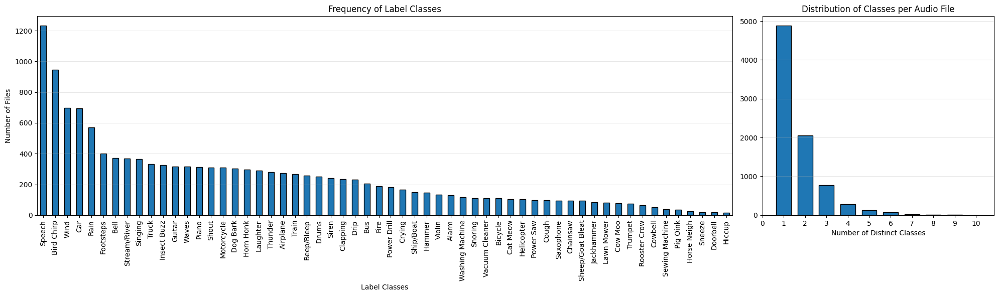

In [9]:
plt.figure(figsize=(20, 6))
gs = gridspec.GridSpec(1, 2, width_ratios=[3, 1])

# Plot label class frequency
plt.subplot(gs[0])
pd.Series(label_counts).sort_values(ascending=False).plot(kind='bar', edgecolor='black')
plt.title('Frequency of Label Classes')
plt.xlabel('Label Classes')
plt.ylabel('Number of Files')
plt.grid(axis='y', alpha=0.3)

# Plot distribution of classes per file
plt.subplot(gs[1])
plt.hist(file_class_counts, bins=np.arange(0, max(file_class_counts)+1) + 0.5, 
         edgecolor='black', rwidth=0.7)
plt.title('Distribution of Classes per Audio File')
plt.xlabel('Number of Distinct Classes')
plt.xticks(range(0, max(file_class_counts)+1))
plt.grid(axis='y', alpha=0.3)

plt.tight_layout()

# Save the figure
plt.savefig('label_class_distribution.png', bbox_inches='tight', dpi=300)
plt.show()

#### Print files with most and least diverse label classes

In [10]:
# Show top 3 most/least diverse files
N = 3
metadata['distinct_classes'] = file_class_counts
del file_class_counts, label_counts

print("\n=== Top 3 Most Diverse Files ===")
most_diverse_files = metadata.nlargest(N, 'distinct_classes')[['filename', 'distinct_classes']]
print(most_diverse_files.to_string(index=False))

print("\n=== Top 3 Least Diverse Files ===")
least_diverse_files = metadata.nsmallest(N, 'distinct_classes')[['filename', 'distinct_classes']]
print(least_diverse_files.to_string(index=False))


=== Top 3 Most Diverse Files ===
  filename  distinct_classes
368502.mp3                10
448708.mp3                10
337099.mp3                10

=== Top 3 Least Diverse Files ===
  filename  distinct_classes
321771.mp3                 1
199414.mp3                 1
410952.mp3                 1


#### Play audio files with most diverse label classes

In [11]:
# Play the audio for most diverse files
print("Play audio file with most diverse label classes")
print("=" * 80)

for sample_file in most_diverse_files.head(3)['filename']:
    file_to_play = os.path.join(DATA_DIR, "audio", sample_file)

    # print sample file name
    print(f"Playing '{sample_file}':")
    with np.load(os.path.join(DATA_DIR, 'labels', sample_file.replace('.mp3', '_labels.npz'))) as data:
        
        # print active classes in sample file
        active_classes = [cls for cls in data.keys() if data[cls].sum() > 0]
        print("Active classes:", sorted(set(active_classes)),"\n")

    # print annotations in sample file
    file_annotations = annotations[annotations['filename'] == sample_file].sort_values('onset')
    print(f"Number of annotations: {len(file_annotations)}")
    print(file_annotations[['onset', 'offset', 'text', 'categories']].head(len(file_annotations)))
    
    y, sr = librosa.load(file_to_play, sr=None)
    display(Audio(y, rate=sr, autoplay=False))

Play audio file with most diverse label classes
Playing '368502.mp3':
Active classes: ['Airplane', 'Bus', 'Car', 'Helicopter', 'Horse Neigh', 'Motorcycle', 'Ship/Boat', 'Shout', 'Train', 'Truck'] 

Number of annotations: 5
           onset     offset  \
15175   0.000000   1.779303   
15172   1.779303   6.738636   
15171   4.075992  11.029154   
15173   8.820799  18.827800   
15174  14.713951  18.827800   

                                                    text  \
15175                 A horse neighs repeatedly outside.   
15172   Children shouting loudly in a repeating pattern.   
15171  A motorcycle engine whirrs with increasing int...   
15173  Children shouting loudly in a repeating patter...   
15174          Engines whirring muffled in the distance.   

                                              categories  
15175                                    ['Horse Neigh']  
15172                                          ['Shout']  
15171                                     ['Motorcyc

Playing '448708.mp3':
Active classes: ['Bell', 'Bird Chirp', 'Bus', 'Car', 'Horn Honk', 'Motorcycle', 'Singing', 'Speech', 'Truck', 'Wind'] 

Number of annotations: 5
           onset     offset  \
20232   0.000000  21.360000   
20235   0.000000  21.360000   
20233   8.410660  12.004643   
20234  19.859533  21.360000   
20236  20.582035  21.360000   

                                                    text  \
20232  A church bell rings constantly in the distance...   
20235  Constant white noise with a soft, indistinct h...   
20233      Birds are singing cheerfully in the distance.   
20234                   Traffic sounds are heard nearby.   
20236  People are talking in the distance with muffle...   

                                              categories  
20232                                   ['Bell', 'Wind']  
20235                                           ['Wind']  
20233                          ['Singing', 'Bird Chirp']  
20234  ['Car', 'Bus', 'Truck', 'Motorcycle', 'Hor

Playing '337099.mp3':
Active classes: ['Airplane', 'Bus', 'Car', 'Footsteps', 'Helicopter', 'Motorcycle', 'Ship/Boat', 'Siren', 'Train', 'Truck'] 

Number of annotations: 5
          onset     offset                                               text  \
1638   0.000000  15.679728  Emergency vehicle sirens sound from a distance...   
1639   0.000000  15.679728  An electronic siren tone rises and falls rhyth...   
1641   0.000000  15.679728  Engines hum in the distance, gradually becomin...   
1640   0.239751   2.517388   Footsteps of a person in high heels on concrete.   
1642  12.634888  15.679728  A rhythmic police siren sounds softly in the d...   

                                             categories  
1638                                          ['Siren']  
1639                                          ['Siren']  
1641  ['Airplane', 'Helicopter', 'Motorcycle', 'Truc...  
1640                                      ['Footsteps']  
1642                                          ['Si

#### Play audio frames on labeled segment for most diverse file (only first category choosen)

Playing '368502.mp3':
Airplane label frames:
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.] 



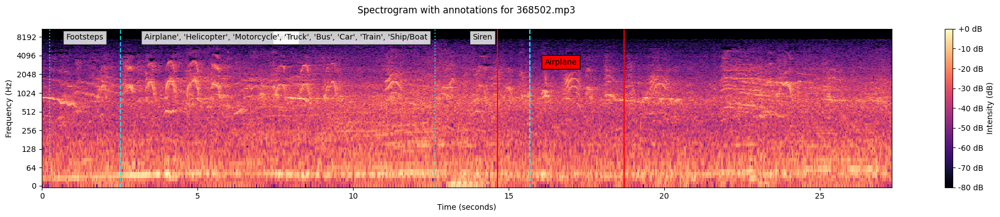

Playing 'Airplane' segment (14.6s–18.7s):


Playing '448708.mp3':
Bell label frames:
 [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.] 



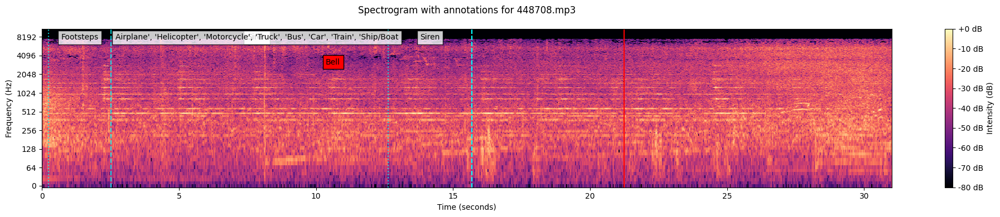

Playing 'Bell' segment (0.0s–21.2s):


Playing '337099.mp3':
Airplane label frames:
 [0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5 0.5
 0.5 0.5 0.5 0.5 0.5] 



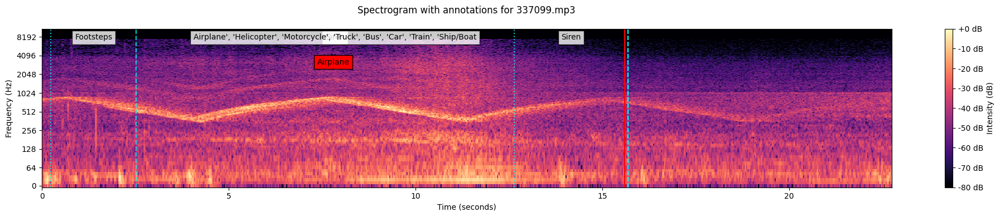

Playing 'Airplane' segment (0.0s–15.6s):


In [12]:
# choose first most diverse file
for sample_file in most_diverse_files['filename']:
    file_to_play = os.path.join(DATA_DIR, "audio", sample_file)

    # load sample file
    print(f"Playing '{sample_file}':")
    with np.load(os.path.join(DATA_DIR, 'labels', sample_file.replace('.mp3', '_labels.npz'))) as data:
        active_classes = [cls for cls in data.keys() if data[cls].sum() > 0]

        # Choose first active class
        cls = active_classes[0]
        print(f"{cls} label frames:\n", data[cls].mean(-1),"\n")         # .mean(-1) removes last dimension
        
        # Extract active class timestamps
        frames = np.where(data[cls].mean(axis=1) > 0)[0]
        if len(frames) > 0:
            start = frames[0] * 0.12 # convert frame index to seconds (120ms/f)
            end = frames[-1] * 0.12
            
            # Create the audio segment
            audio_path = os.path.join(DATA_DIR, 'audio', sample_file)
            y_segment, sr_segment = librosa.load(audio_path, sr=None, offset=start, duration=end-start)

            # Create spectrogram
            plt.figure(figsize=(20, 4))
            y, sr = librosa.load(audio_path, sr=None) # Load entire audio file
            D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
            librosa.display.specshow(D, y_axis='log', x_axis='time')
            
            # Add colorbar with label
            cbar = plt.colorbar(format='%+2.0f dB')
            cbar.set_label('Intensity (dB)')

            # Add vertical lines for choosen category and the related audio segment
            plt.axvline(x=start, color='red', linestyle='-')
            plt.axvline(x=end, color='red', linestyle='-')
            
            # Add single centered label
            plt.text((start + end)/2, sr/10, cls, 
                     ha='center', va='center',
                     bbox=dict(facecolor='red'))
        
            # Add vertical lines for each annotation
            for _, row in file_annotations.iterrows():
                onset = row['onset']
                offset = row['offset']
                label = row['categories'].strip("[]'")  # Clean label format
                
                # Add vertical lines
                plt.axvline(x=onset, color='cyan', linestyle=':', alpha=0.8)
                plt.axvline(x=offset, color='cyan', linestyle='--', alpha=0.8)
                
                # Add single centered label
                plt.text((onset + offset)/2, sr/4, label, 
                         ha='center', va='center',
                         bbox=dict(facecolor='white', alpha=0.8))
            
            # Axis labels
            plt.ylabel('Frequency (Hz)')
            plt.xlabel('Time (seconds)')
            plt.title(f'Spectrogram with annotations for {sample_file}', pad=20)
            
            plt.tight_layout()

            # Save the figure
            plt.savefig(f'spectogram_(cls={len(active_classes)})_{sample_file}.png', bbox_inches='tight', dpi=300)
            plt.show()

            # Play the labeled audio (y, sr)
            print(f"Playing '{cls}' segment ({start:.1f}s–{end:.1f}s):")
            display(Audio(y_segment, rate=sr_segment, autoplay=False))

#### Play audio files with least diverse label classes

In [13]:
# Play the audio for least diverse files
print("Play audio file with least diverse label classes")
print("=" * 80)

for sample_file in least_diverse_files['filename']:
    file_to_play = os.path.join(DATA_DIR, "audio", sample_file)

    # print sample file name
    print(f"Playing '{sample_file}':")
    with np.load(os.path.join(DATA_DIR, 'labels', sample_file.replace('.mp3', '_labels.npz'))) as data:
        
        # print active classes in sample file
        active_classes = [cls for cls in data.keys() if data[cls].sum() > 0]
        print("Active classes:", sorted(set(active_classes)),"\n")

    # print annotations in sample file
    file_annotations = annotations[annotations['filename'] == sample_file].sort_values('onset')
    print(f"Number of annotations: {len(file_annotations)}")
    print(file_annotations[['onset', 'offset', 'text', 'categories']].head(len(file_annotations)))
    
    y, sr = librosa.load(file_to_play, sr=None)
    display(Audio(y, rate=sr, autoplay=False))

Play audio file with least diverse label classes
Playing '321771.mp3':
Active classes: ['Speech'] 

Number of annotations: 1
          onset     offset                  text  categories
16550  0.038424  21.978526  People are speaking.  ['Speech']


Playing '199414.mp3':
Active classes: ['Cough'] 

Number of annotations: 2
           onset     offset                            text categories
16318   2.091606   2.888408  A cough fades in the distance.  ['Cough']
16319  12.516434  13.080836  A cough fades in the distance.  ['Cough']


Playing '410952.mp3':
Active classes: ['Speech'] 

Number of annotations: 2
          onset     offset                  text  categories
16736  0.018957   3.525955  Someone is speaking.  ['Speech']
16735  8.881235  22.681746  Someone is speaking.  ['Speech']


#### Play audio frames on labeled segment for most diverse file (only first category choosen)

Playing '321771.mp3':
Speech label frames:
 [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.] 



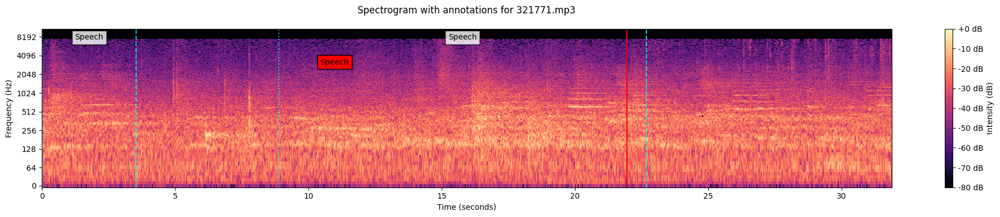

Playing 'Speech' segment (0.0s–22.0s):


Playing '199414.mp3':
Cough label frames:
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0.] 



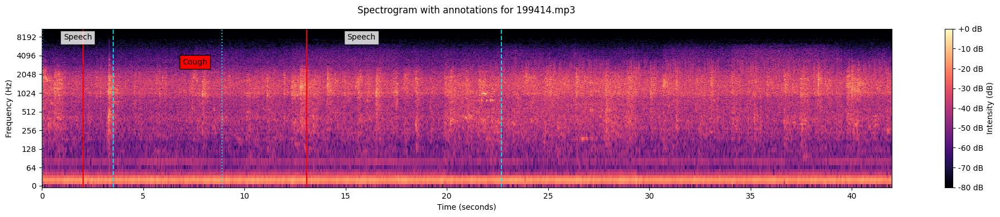

Playing 'Cough' segment (2.0s–13.1s):


Playing '410952.mp3':
Speech label frames:
 [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.] 



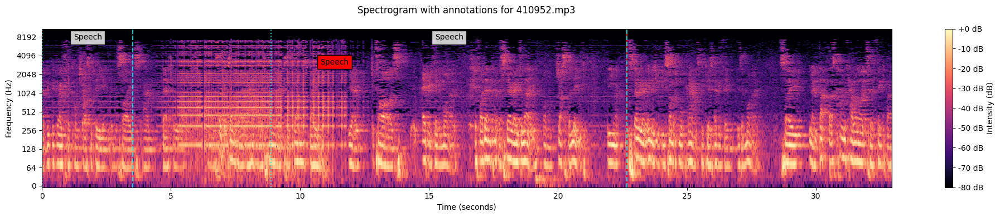

Playing 'Speech' segment (0.0s–22.7s):


In [14]:
# choose first least diverse file
for sample_file in least_diverse_files['filename']:
    file_to_play = os.path.join(DATA_DIR, "audio", sample_file)

    # load sample file
    print(f"Playing '{sample_file}':")
    with np.load(os.path.join(DATA_DIR, 'labels', sample_file.replace('.mp3', '_labels.npz'))) as data:
        active_classes = [cls for cls in data.keys() if data[cls].sum() > 0]

        # Choose first active class
        cls = active_classes[0]
        print(f"{cls} label frames:\n", data[cls].mean(-1),"\n")         # .mean(-1) removes last dimension
        
        # Extract active class timestamps
        frames = np.where(data[cls].mean(axis=1) > 0)[0]
        if len(frames) > 0:
            start = frames[0] * 0.12 # convert frame index to seconds (120ms/f)
            end = frames[-1] * 0.12
            
            # Create the audio segment
            audio_path = os.path.join(DATA_DIR, 'audio', sample_file)
            y_segment, sr_segment = librosa.load(audio_path, sr=None, offset=start, duration=end-start)

            # Create spectrogram
            plt.figure(figsize=(20, 4))
            y, sr = librosa.load(audio_path, sr=None) # Load entire audio file
            D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
            librosa.display.specshow(D, y_axis='log', x_axis='time')
            
            # Add colorbar with label
            cbar = plt.colorbar(format='%+2.0f dB')
            cbar.set_label('Intensity (dB)')

            # Add vertical lines for choosen category and the related audio segment
            plt.axvline(x=start, color='red', linestyle='-')
            plt.axvline(x=end, color='red', linestyle='-')
            
            # Add single centered label
            plt.text((start + end)/2, sr/10, cls, 
                     ha='center', va='center',
                     bbox=dict(facecolor='red'))
        
            # Add vertical lines for each annotation
            for _, row in file_annotations.iterrows():
                onset = row['onset']
                offset = row['offset']
                label = row['categories'].strip("[]'")  # Clean label format
                
                # Add vertical lines
                plt.axvline(x=onset, color='cyan', linestyle=':', alpha=0.8)
                plt.axvline(x=offset, color='cyan', linestyle='--', alpha=0.8)
                
                # Add single centered label
                plt.text((onset + offset)/2, sr/4, label, 
                         ha='center', va='center',
                         bbox=dict(facecolor='white', alpha=0.8))
            
            # Axis labels
            plt.ylabel('Frequency (Hz)')
            plt.xlabel('Time (seconds)')
            plt.title(f'Spectrogram with annotations for {sample_file}', pad=20)
            
            plt.tight_layout()

            # Save the figure
            plt.savefig(f'spectogram_(cls={len(active_classes)})_{sample_file}.png', bbox_inches='tight', dpi=300)
            plt.show()

            # Play the labeled audio (y, sr)
            print(f"Playing '{cls}' segment ({start:.1f}s–{end:.1f}s):")
            display(Audio(y_segment, rate=sr_segment, autoplay=False))